In [1]:
import sys
!{sys.executable} --version

Python 3.10.6


In [3]:

from roboflow import Roboflow
rf = Roboflow(api_key="Kj7IpsRDsn3rStIiSpwR")
project = rf.workspace("insper").project("auto-robert2")
dataset = project.version(1).download("coco")

loading Roboflow workspace...
loading Roboflow project...

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



## Setup TAO mounts.

Since the TAO Toolkit abstracts operations into Docker containers, we need to specify how the Docker containers can access outside data. We do this with a file called `~/.tao_mounts.json` where we specify the mapping from "source" directories to "destination" directories. See more here: https://docs.nvidia.com/tao/tao-toolkit/text/tao_launcher.html#running-the-launcher

In [4]:
import os

%env KEY=tlt_encode
%env NUM_GPUS=1
%env USER_EXPERIMENT_DIR=/workspace/project/detectnet_v2
%env DATA_DOWNLOAD_DIR=/workspace/project/data

# Set this path if you don't run the notebook from the samples directory.
# %env NOTEBOOK_ROOT=~/tao-samples/detectnet_v2

# Please define this local project directory that needs to be mapped to the TAO docker session.
# The dataset expected to be present in $LOCAL_PROJECT_DIR/data, while the results for the steps
# in this notebook will be stored at $LOCAL_PROJECT_DIR/detectnet_v2
# !PLEASE MAKE SURE TO UPDATE THIS PATH!.

os.environ["LOCAL_PROJECT_DIR"] = "/home/antonio/Desktop/pfe/tao/project/"

os.environ["LOCAL_DATA_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "Auto-Robert-2"
)
os.environ["LOCAL_EXPERIMENT_DIR"] = os.path.join(
    os.getenv("LOCAL_PROJECT_DIR", os.getcwd()),
    "detectnet_v2"
)

# Make the experiment directory 
! mkdir -p $LOCAL_EXPERIMENT_DIR

env: KEY=tlt_encode
env: NUM_GPUS=1
env: USER_EXPERIMENT_DIR=/workspace/project/detectnet_v2
env: DATA_DOWNLOAD_DIR=/workspace/project/data


In [5]:
# Mapping up the local directories to the TAO docker.
import json
mounts_file = os.path.expanduser("~/.tao_mounts.json")

# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
        # Mapping the data directory
        {
            "source": os.environ["LOCAL_PROJECT_DIR"],
            "destination": "/workspace/project"
        },
    ],
    "DockerOptions": {
        # preserving the same permissions with the docker as in host machine.
        "user": "{}:{}".format(os.getuid(), os.getgid())
    }
}

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)

In [6]:
!cat ~/.tao_mounts.json

{
    "Mounts": [
        {
            "source": "/home/antonio/Desktop/pfe/tao/project/",
            "destination": "/workspace/project"
        }
    ],
    "DockerOptions": {
        "user": "1000:1000"
    }
}

In [10]:
# Specify RF COCO dataset details

dataset_config = """
coco_config {
  root_directory_path: "/workspace/project/Auto-Robert-2"
  img_dir_names: ["test", "train", "valid"]
  annotation_files: [ "test/_annotations.coco.json", "train/_annotations.coco.json", "valid/_annotations.coco.json"]
  num_partitions: 3
  num_shards: [1, 72, 2]
}
image_directory_path: "/workspace/project/Auto-Robert-2"
"""

# write the dataset config to a JSON file
file_object = open('coco_config.json', 'w')
file_object.write(dataset_config)
file_object.close()
!cat coco_config.json


coco_config {
  root_directory_path: "/workspace/project/Auto-Robert-2"
  img_dir_names: ["test", "train", "valid"]
  annotation_files: [ "test/_annotations.coco.json", "train/_annotations.coco.json", "valid/_annotations.coco.json"]
  num_partitions: 3
  num_shards: [1, 72, 2]
}
image_directory_path: "/workspace/project/Auto-Robert-2"


In [8]:
!tao bpnet run ls /workspace/project/Auto-Robert-2/test

2022-11-11 19:39:48,648 [INFO] root: Registry: ['nvcr.io']
2022-11-11 19:39:48,716 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
2022-11-10-182659_jpg.rf.cafe776877ae513adfbd414cd3ecdb8d.jpg
2022-11-10-182704_jpg.rf.0ddc10339b6b9298afa228b5f1cc635a.jpg
2022-11-10-182734_jpg.rf.2bd3a781d4c182e62fceeb64f2dffbb7.jpg
2022-11-10-182749_jpg.rf.26c9403b5b737b5f18ee5d1c83bb4519.jpg
2022-11-10-182826_jpg.rf.21d4d06a79295789e2b3286d558d4803.jpg
2022-11-10-182844_jpg.rf.d73f54cfd0b551c102efea410ab1ddfb.jpg
2022-11-10-183013_jpg.rf.0c534e1ff3391b6fc047a8aa811a875f.jpg
2022-11-10-183015_jpg.rf.d451d8d5099392c8c73241485976446d.jpg
2022-11-10-183036_jpg.rf.cfff946a867a35815905a3aea1db7c74.jpg
2022-11-10-183055_jpg.rf.a98f9c8f9710a684525e08c08d48166a.jpg
2022-11-10-183122_jpg.rf.47059d18da432dcea0d9979cff52d3c9.jpg
2022-11-10-183123_jpg.rf.ece56c377b08eaffc5030d6b5d17ff34.jpg
2022-11-10-183152_jpg.rf.978fe06

In [13]:
# Convert to TFRecords. We'll move the TFRecord files to a custom directory
# in the next cell.

!tao detectnet_v2 dataset_convert -d "/workspace/project/coco_config.json" --gpu_index 0 -o "/workspace/project/output.tfrecords"

2022-11-11 19:51:26,914 [INFO] root: Registry: ['nvcr.io']
2022-11-11 19:51:26,987 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-vdlysyr9 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-11 22:51:34,380 [INFO] iva.detectnet_v2.dataio.build_converter: Instantiating a coco converter
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
load

In [14]:
!mkdir output_tfrecords

In [15]:

!mv output.tfrecords* output_tfrecords

In [20]:
# Download NVIDIA pretrained Resnet18 model.

# !wget https://api.ngc.nvidia.com/v2/models/nvidia/tao/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5 ./project/resnet_18.hdf5

--2022-11-07 16:45:18--  https://api.ngc.nvidia.com/v2/models/nvidia/tao/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 54.215.161.153, 54.177.25.114
Connecting to api.ngc.nvidia.com (api.ngc.nvidia.com)|54.215.161.153|:443... connected.
HTTP request sent, awaiting response... 302 
Location: https://prod-model-registry-ngc-bucket.s3.us-west-2.amazonaws.com/org/nvidia/team/tao/models/pretrained_object_detection/versions/resnet18/files/resnet_18.hdf5?response-content-disposition=attachment%3B%20filename%3D%22resnet_18.hdf5%22&response-content-type=application%2Foctet-stream&X-Amz-Security-Token=IQoJb3JpZ2luX2VjEDsaCXVzLXdlc3QtMiJGMEQCIE4rEo%2F0iSG4xecHcOge0jPFl1CSZjHmCb84TUQ%2Bn455AiBg8xyCdmnoz4hkvtNfv0UwTx4AVdYeM90aLxnFA2jYRSrMBAg0EAQaDDc4OTM2MzEzNTAyNyIMo8xEZD0Ouys%2BRVkkKqkEGe6X0YfrzOkl5t6zWvf5bQNOMDB6UMh4uMG%2Brxm8R6rM0ysBrh6fJwhHG5bSxk68Of%2F2%2B8xhnguRYONlelTgJSNiiM37t1%2FLUbbTTgd75wByevPfryL%2FldNb81LkPFZfSR%

In [22]:
# !ngc registry model list nvidia/tao/pretrained_detectnet_v2:*

/bin/bash: line 1: ngc: command not found


In [29]:
# Train our model

!tao detectnet_v2 train -e "/workspace/project/experiment_spec.json" -r "/workspace/project/resnet18_unpruned" -k "roboflow" --use_amp

# Logs will be saved to the "run1" directory, including a CSV of 
# training accuracy over time.

2022-11-11 20:00:58,074 [INFO] root: Registry: ['nvcr.io']
2022-11-11 20:00:58,131 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-sm8uh580 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-11 23:01:03,619 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [30]:
!tao detectnet_v2 evaluate -e /workspace/project/experiment_spec.json\
                           -m /workspace/project/resnet18_unpruned/weights/model.tlt \
                           -k "roboflow"

2022-11-11 21:34:13,436 [INFO] root: Registry: ['nvcr.io']
2022-11-11 21:34:13,484 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-f5v7jquw because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-12 00:34:18,847 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [45]:
!tao detectnet_v2 prune \
                  -m /workspace/project/resnet18_unpruned/weights/model.tlt \
                  -o /workspace/project/resnet18_pruned/model_pruned.tlt \
                  -eq union \
                  -pth 0.0000052 \
                  -k "roboflow"

2022-11-11 21:53:48,847 [INFO] root: Registry: ['nvcr.io']
2022-11-11 21:53:48,897 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-x30eep87 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-12 00:53:55,336 [INFO] modulus.pruning.pruning: Exploring graph for retainable indices
2022-11-12 00:53:55,675 [INFO] modulus.pruning.pruning: Pruning model and appending pruned node

In [46]:
!tao detectnet_v2 train -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                        -r /workspace/project/experiment_dir_retrain \
                        -k "roboflow" \
                        -n resnet18_detector_pruned 

2022-11-11 21:54:56,927 [INFO] root: Registry: ['nvcr.io']
2022-11-11 21:54:56,977 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-2b7rwp7b because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-12 00:55:01,919 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [59]:
!tao detectnet_v2 evaluate -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                           -m /workspace/project/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
                           -k "roboflow"

2022-11-12 00:10:21,278 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:10:21,333 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-2llhqhvw because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.

2022-11-12 03:10:26,941 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/b770f990bb7b9e2db5771981fb3a38b4/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_whe

In [60]:
!tao detectnet_v2 inference -e /workspace/project/detectnet_v2_inference.txt \
                            -o /workspace/project/tlt_infer_testing \
                            -i /workspace/project/Auto-Robert-2/test \
                            -k "roboflow"

2022-11-12 00:11:42,893 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:11:42,945 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-kfs69joa because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
INFO: Merging specification from /workspace/project/detectnet_v2_inference.txt
INFO: Overlain images will be saved in the output path.
INFO: Constructing inferencer




INFO: Loading model f

In [61]:
# Simple grid visualizer
%matplotlib inline
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join("/home/antonio/Desktop/pfe/tao/project/", image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower()
         in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

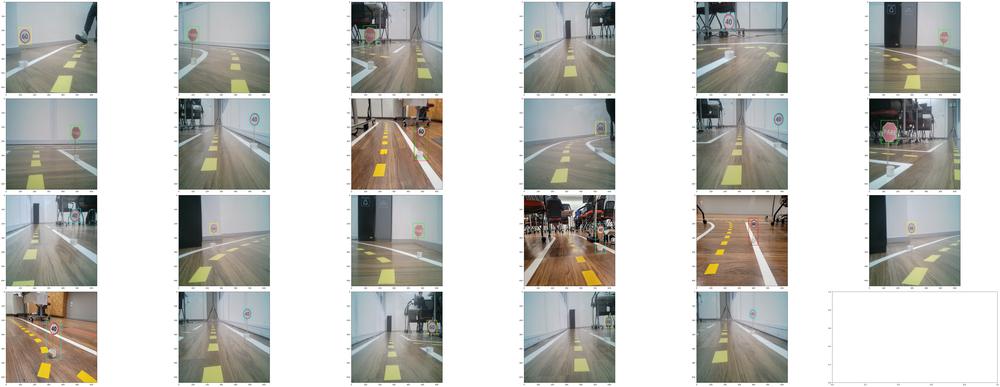

In [62]:
OUTPUT_PATH = 'tlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 6 # number of columns in the visualizer grid.
IMAGES = 23 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

In [63]:
!tao detectnet_v2 calibration_tensorfile -e /workspace/project/detectnet_v2_retrain_resnet18.txt \
                                         -m 10 \
                                         -o /workspace/project/experiment_dir_final/calibration.tensor

2022-11-12 00:15:36,710 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:15:36,764 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-uhc23y2i because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
Using TensorFlow backend.
2022-11-12 03:15:42,248 [INFO] __main__: This method is soon to be deprecated. Please use the -e option in the export command to instantiate the dataloader and generate samples for calibrati

In [66]:
!rm -rf /workspace/project/experiment_dir_final/resnet18_detector.etlt
!rm -rf /workspace/project/experiment_dir_final/calibration.bin
!tao detectnet_v2 export \
                  -m /workspace/project/experiment_dir_retrain/weights/resnet18_detector_pruned.tlt \
                  -o /workspace/project/experiment_dir_final/resnet18_detector.etlt \
                  -k "roboflow"  \
                  --cal_data_file /workspace/project/experiment_dir_final/calibration.tensor \
                  --data_type int8 \
                  --batches 10 \
                  --batch_size 4 \
                  --max_batch_size 4\
                  --engine_file /workspace/project/experiment_dir_final/resnet18_detector.trt.int8 \
                  --cal_cache_file /workspace/project/experiment_dir_final/calibration.bin \
                  --verbose

2022-11-12 00:18:34,341 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:18:34,393 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-_uc6rbad because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
2022-11-12 03:18:42,457 [INFO] iva.common.export.keras_exporter: Using input nodes: ['input_1']
2022-11-12 03:18:42,457 [INFO] iva.common.export.keras_exporter: Using output nodes: ['output_

In [53]:
# !ngc registry resource download-version nvidia/tao/tao-converter:v3.21.11_trt7.1_agx --dest /home/antonio/Desktop/pfe/tao/project

In [54]:
# !tao bpnet run cat /usr/local/lib/python3.6/dist-packages/tensorrt/__init__.py

In [55]:
# !tao bpnet run cat /usr/include/cudnn_version.h

In [67]:
!tao converter /workspace/project/experiment_dir_final/resnet18_detector.etlt \
                   -k "roboflow" \
                    -c /workspace/project/experiment_dir_final/calibration.bin \
                   -o output_cov/Sigmoid,output_bbox/BiasAdd \
                   -d 3,640,640 \
                   -i nchw \
                   -t int8 \
                   -e /workspace/project/experiment_dir_final/resnet18_int8_detector.engine

2022-11-12 00:20:52,354 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:20:52,409 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.5-py3
[INFO] [MemUsageChange] Init CUDA: CPU +473, GPU +0, now: CPU 484, GPU 330 (MiB)
[INFO] [MemUsageSnapshot] Begin constructing builder kernel library: CPU 484 MiB, GPU 330 MiB
[INFO] [MemUsageSnapshot] End constructing builder kernel library: CPU 638 MiB, GPU 372 MiB
[INFO] Reading Calibration Cache for calibrator: EntropyCalibration2
[INFO] Generated calibration scales using calibration cache. Make sure that calibration cache has latest scales.
[INFO] To regenerate calibration cache, please delete the existing one. TensorRT will generate a new calibration cache.
[WARNING] Missing scale and zero-point for tensor output_bbox/bias, expect fall back to non-int8 implementation for any layer consuming or producing given tensor
[WARNING] Missing scale and zero-point for te

In [68]:
!tao detectnet_v2 inference -e /workspace/project/detectnet_v2_inference_etlt.txt \
                            -o /workspace/project/etlt_infer_testing \
                            -i /workspace/project/Auto-Robert-2/test \
                            -k "roboflow"

2022-11-12 00:26:25,087 [INFO] root: Registry: ['nvcr.io']
2022-11-12 00:26:25,137 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.22.05-tf1.15.4-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-cedmyod5 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/requests/__init__.py:91: RequestsDependencyWarning: urllib3 (1.26.5) or chardet (3.0.4) doesn't match a supported version!
  RequestsDependencyWarning)
INFO: Merging specification from /workspace/project/detectnet_v2_inference_etlt.txt
INFO: Overlain images will be saved in the output path.
INFO: Constructing inferencer
INFO: Engine file no

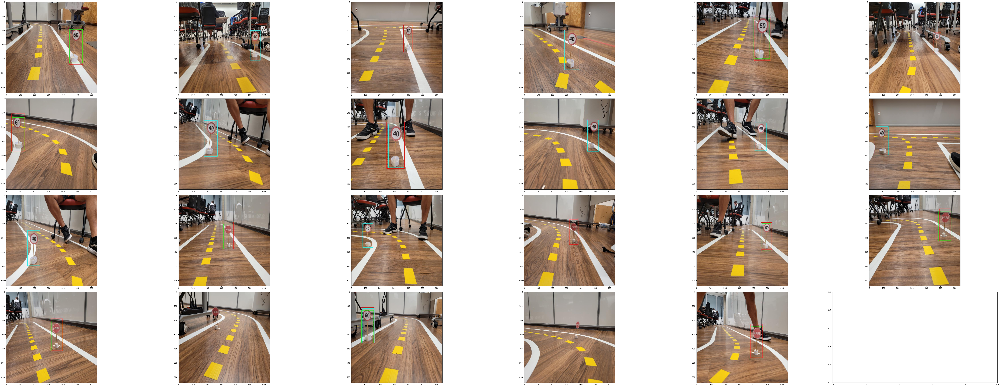

In [69]:
OUTPUT_PATH = 'etlt_infer_testing/images_annotated' # relative path from $USER_EXPERIMENT_DIR.
COLS = 6 # number of columns in the visualizer grid.
IMAGES = 23 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)